# **MACHINE AND DEEP LEARNING PROJECT**
##Music Genre Classification 🎵
Maria Critelli 247340

In [ ]:
from PIL import Image
import requests
from io import BytesIO

url = "https://townsquare.media/site/295/files/2024/01/attachment-1979-albums.jpg?w=780&q=75"

response = requests.get(url)
img = Image.open(BytesIO(response.content))
display(img)


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
!pip install evaluate # libreria evaluate

Installiamo le librerie necessarie

In [ ]:
# Transformers
from transformers import AutoFeatureExtractor
from transformers import AutoModelForAudioClassification
from transformers import TrainingArguments
from transformers import Trainer

# Evaluate
import evaluate

In [ ]:
!pip install --upgrade datasets


# EDA - Exploratory Data Analysis

Caricamento del dataset

In [ ]:
# carimento dei dati con l'apposita librera
from datasets import load_dataset

dataset = load_dataset("marsyas/gtzan")

/usr/local/lib/python3.11/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


In [ ]:
dataset

DatasetDict({
    train: Dataset({
        features: ['file', 'audio', 'genre'],
        num_rows: 999
    })
})

In [ ]:
# generi
unique_genres = set(example["genre"] for example in dataset["train"])


print("Unique genres:", unique_genres)
print("Number of unique genres:", len(unique_genres))

Unique genres: {0, 1, 2, 3, 4, 5, 6, 7, 8, 9}
Number of unique genres: 10


In [ ]:
seed = 42

In [ ]:
# splitting dei dati in training e test
dataset = dataset['train'].train_test_split(seed = seed, shuffle = True,
                                  test_size = .2)

In [ ]:
dataset

DatasetDict({
    train: Dataset({
        features: ['file', 'audio', 'genre'],
        num_rows: 799
    })
    test: Dataset({
        features: ['file', 'audio', 'genre'],
        num_rows: 200
    })
})

Abbiamo eseguito lo split del dataset in dataset di train con 799 samples e un dataset di test con 200 samples. Consideriamo un file di audio




In [ ]:
# prendiamo il terzo file
print("file:", dataset['train'][2]['file'])
print('\n')
print("audio: ", dataset['train'][2]['audio'])
print('\n')
print("genre:", dataset['train'][2]['genre'])
print('\n')

file: /root/.cache/huggingface/datasets/downloads/extracted/5022b0984afa7334ff9a3c60566280b08b5179d4ac96a628052bada7d8940244/genres/disco/disco.00088.wav


audio:  {'path': '/root/.cache/huggingface/datasets/downloads/extracted/5022b0984afa7334ff9a3c60566280b08b5179d4ac96a628052bada7d8940244/genres/disco/disco.00088.wav', 'array': array([ 0.03372192,  0.05703735,  0.06817627, ..., -0.00717163,
        0.00860596,  0.02481079]), 'sampling_rate': 22050}


genre: 3




Il campo "file" descrive il percorso audio,mentre i file audio (campo "audio") sono rappresentati come array unidimensionali, dove il valore dell'array rappresenta l'ampiezza in quel particolare passo temporale. Questa particolare canzone ha una frequenza di campionamento di 22.050 Hz.

Il genere musicale è rappresentato come un numero intero; successivamente si otterranno le etichette e si procederà con un mapping.

In [ ]:
# mapping delle etichette
id2label_function = dataset['train'].features['genre'].int2str

In [ ]:
print("genre: ", id2label_function(dataset['train'][2]['genre']))


genre:  disco


Vediamo che l'id 3 si riferisce al genere disco.

Verifichiamo se tutte le frequenze di campionamento sono le stesse nel set di dati

In [ ]:
# vediamo se si ha la stessa frequenza di campionamento nel dataset
sampling_rate_check = None
all_same = True

# iteriamo su ciascun semple
for set_name in ['train', 'test']:
    for sample in dataset[set_name]:
        sampling_rate = sample['audio']['sampling_rate']

        if sampling_rate_check is None:
            sampling_rate_check = sampling_rate
        else:
            if sampling_rate != sampling_rate_check:
                all_same = False
            break

# risultati
if all_same:
    print(f"All samples have the same sampling rate: {sampling_rate_check} Hz")
else:
    print("The samples in the dataframe have different sampling rates.")

All samples have the same sampling rate: 22050 Hz


Tutti i file audio hanno lo stesso sampling rate (22050 Hz)


Procediamo con un conteggio delle etichette.

In [ ]:
import plotly.express as px

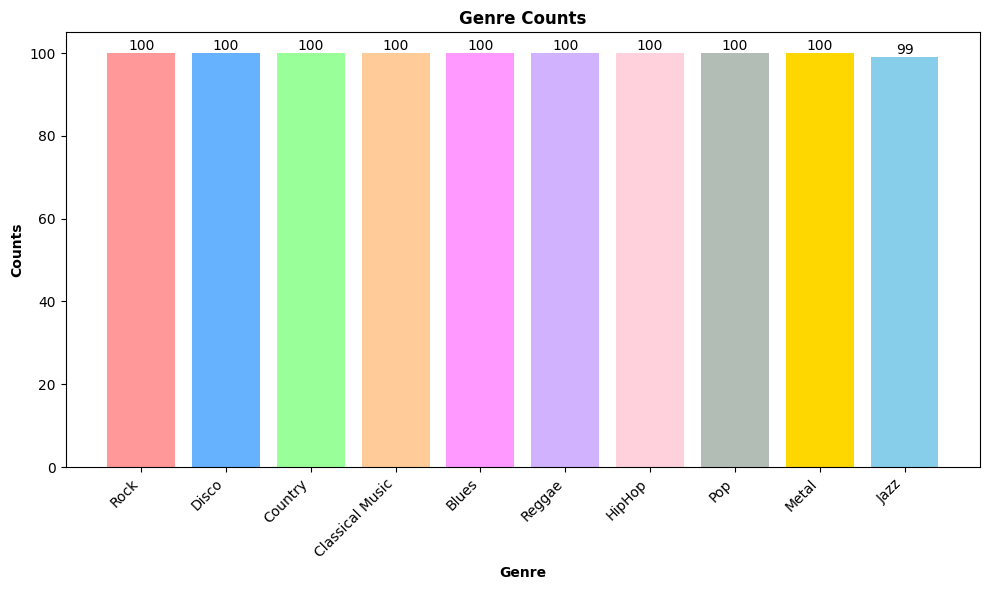

In [ ]:
import matplotlib.pyplot as plt

# definiamo i generi
genres = ["Rock", "Disco", "Country", "Classical Music", "Blues", "Reggae", "HipHop", "Pop", "Metal", "Jazz"]
counts = [100, 100, 100, 100, 100, 100, 100, 100, 100, 99]  # Update the counts with your actual data

# colori per ciascun genere
colors = ['#FF9999', '#66B2FF', '#99FF99', '#FFCC99', '#FF99FF', '#D1B2FF', '#FFD1DC', '#B2BEB5', '#FFD700', '#87CEEB']
# bar plot per ciascun genere
plt.figure(figsize=(10, 6))
bars = plt.bar(genres, counts, color=colors)
plt.xlabel('Genre', fontweight='bold')
plt.ylabel('Counts', fontweight='bold')
plt.title('Genre Counts', fontweight='bold')

# aggiungiamo il conteggio delle tracce per ciascun genere
for bar, count in zip(bars, counts):
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width() / 2, height, count, ha='center', va='bottom')

plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()



Complessivamente abbiamo 100 campioni per Rock, Disco, Country, Musica Classica, Blues, Reggae, HipHop, Pop e Metal. Jazz è l'unico genere con soli 99 campioni, questo è dovuto a un file corrotto che è stato rimosso dal dataset.

Proseguiamo ora con il processo di "visualizzazione", attraverso le forme d'onda (waveform)che possono essere tracciate utilizzando la libreria **librosa**.

Una forma d'onda illustra i cambiamenti nell'ampiezza del suono nel tempo. Sull'asse x abbiamo la feature tempo, mentre sull'asse y abbiamo i valori di ampiezza in un intervallo di [-1.00, 1.00]. Diamo un'occhiata ad alcuni esempi, ascoltiamo i file e controlliamo i loro generi per vedere come differiscono l'uno dall'altro.



## LIBROSA

Librosa è una libreria Python per l'analisi audio e la manipolazione della musica. È ampiamente utilizzata in progetti di ricerca e sviluppo di applicazioni che coinvolgono il segnale audio, grazie alla sua ricca collezione di funzioni per il caricamento, la manipolazione e l'analisi dei dati audio.

Mette a disposizione alcune visualizzioni del suono offrendo una prospettiva diversa sul segnale audio, permettendo di analizzare diversi aspetti del suono in modo dettagliato.



*   Waveform: Mostra la variazione dell'ampiezza nel tempo. Utile per vedere la struttura generale del segnale audio.
*   Frequency Spectrum: Mostra l'ampiezza delle diverse frequenze in un determinato momento. Utile per analizzare il contenuto frequenziale.
*   Spectrogram: Mostra come lo spettro delle frequenze varia nel tempo. Utile per visualizzare cambiamenti e caratteristiche del suono nel tempo.


In [ ]:
#!pip install librosa


In [ ]:
import librosa

# esempio: consideriamo l'array relativo ad un file audio e il corrispettivo sampling rate
array = dataset['train'][2]['audio']['array']
sampling_rate = dataset['train'][2]['audio']['sampling_rate']


In [ ]:
# file audio
from IPython.display import Audio

Audio(data = array, rate = sampling_rate)

In [ ]:
# print del genere
print("genre: ", id2label_function(dataset['train'][2]['genre']))

genre:  disco


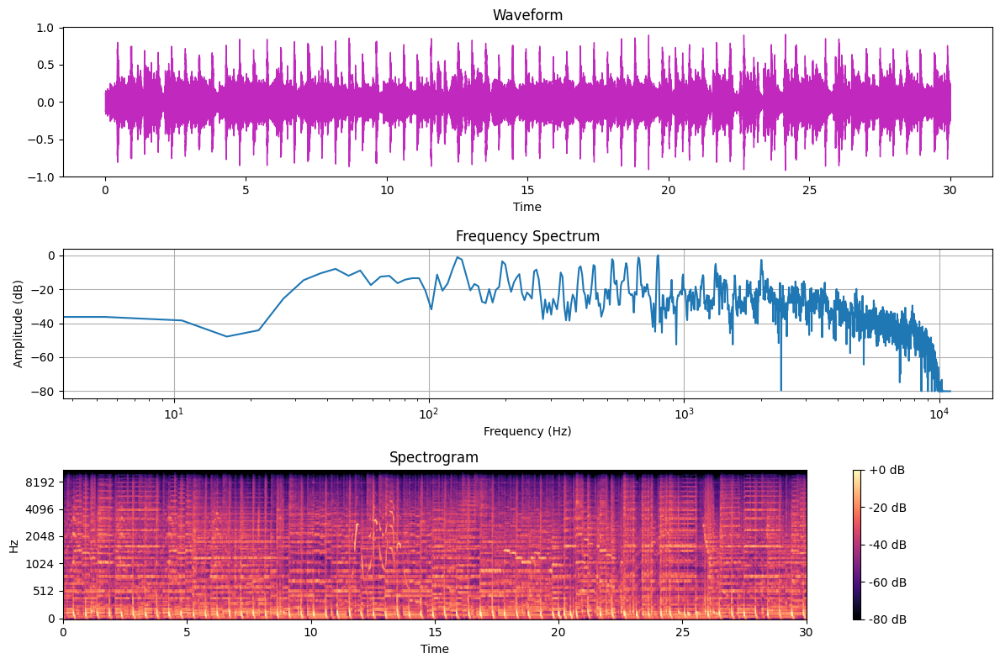

In [ ]:
import numpy as np
# Plot di waveform, frequency spectrum, and spectrogram
plt.figure(figsize=(12, 8))

# Waveform
plt.subplot(3, 1, 1)
plt.title('Waveform')
librosa.display.waveshow(array, sr=sampling_rate, color='#C129BE')

# Frequency Spectrum
plt.subplot(3, 1, 2)
plt.title('Frequency Spectrum')
dft_input = array[:4096]
window = np.hanning(len(dft_input))
windowed_input = dft_input * window
dft = np.fft.rfft(windowed_input)
amplitude = np.abs(dft)
amplitude_db = librosa.amplitude_to_db(amplitude, ref=np.max)
frequency = librosa.fft_frequencies(sr=sampling_rate, n_fft=len(dft_input))
plt.plot(frequency, amplitude_db)
plt.xlabel('Frequency (Hz)')
plt.ylabel('Amplitude (dB)')
plt.xscale('log')
plt.grid(True)

# Spectrogram
plt.subplot(3, 1, 3)
plt.title('Spectrogram')
spec = librosa.feature.melspectrogram(y=array, sr=sampling_rate)
spec_db = librosa.power_to_db(spec, ref=np.max)
librosa.display.specshow(spec_db, sr=sampling_rate, x_axis='time', y_axis='mel')
plt.colorbar(format='%+2.0f dB')

plt.tight_layout()
plt.show()

In [ ]:
array = dataset['train'][14]['audio']['array']
sampling_rate = dataset['train'][14]['audio']['sampling_rate']



In [ ]:
Audio(data = array, rate = sampling_rate)

In [ ]:
# print del genere
print("genre: ", id2label_function(dataset['train'][14]['genre']))

genre:  reggae


In [ ]:
# Plot di waveform, frequency spectrum, and spectrogram
plt.figure(figsize=(12, 8))

# Waveform
plt.subplot(3, 1, 1)
plt.title('Waveform')
librosa.display.waveshow(array, sr=sampling_rate, color='#FFA200')

# Frequency Spectrum
plt.subplot(3, 1, 2)
plt.title('Frequency Spectrum')
dft_input = array[:4096]
window = np.hanning(len(dft_input))
windowed_input = dft_input * window
dft = np.fft.rfft(windowed_input)
amplitude = np.abs(dft)
amplitude_db = librosa.amplitude_to_db(amplitude, ref=np.max)
frequency = librosa.fft_frequencies(sr=sampling_rate, n_fft=len(dft_input))
plt.plot(frequency, amplitude_db)
plt.xlabel('Frequency (Hz)')
plt.ylabel('Amplitude (dB)')
plt.xscale('log')
plt.grid(True)

# Spectrogram
plt.subplot(3, 1, 3)
plt.title('Spectrogram')
spec = librosa.feature.melspectrogram(y=array, sr=sampling_rate)
spec_db = librosa.power_to_db(spec, ref=np.max)
librosa.display.specshow(spec_db, sr=sampling_rate, x_axis='time', y_axis='mel')
plt.colorbar(format='%+2.0f dB')

plt.tight_layout()
plt.show()

In [ ]:
array = dataset['train'][127]['audio']['array']
sampling_rate = dataset['train'][127]['audio']['sampling_rate']


In [ ]:
Audio(data = array, rate = sampling_rate)

In [ ]:
# print del genere
print("genre: ", id2label_function(dataset['train'][127]['genre']))

genre:  blues


In [ ]:
# Plot waveform, frequency spectrum, and spectrogram
plt.figure(figsize=(12, 8))

# Waveform
plt.subplot(3, 1, 1)
plt.title('Waveform')
librosa.display.waveshow(array, sr=sampling_rate, color='#38BB3C')

# Frequency Spectrum
plt.subplot(3, 1, 2)
plt.title('Frequency Spectrum')
dft_input = array[:4096]
window = np.hanning(len(dft_input))
windowed_input = dft_input * window
dft = np.fft.rfft(windowed_input)
amplitude = np.abs(dft)
amplitude_db = librosa.amplitude_to_db(amplitude, ref=np.max)
frequency = librosa.fft_frequencies(sr=sampling_rate, n_fft=len(dft_input))
plt.plot(frequency, amplitude_db)
plt.xlabel('Frequency (Hz)')
plt.ylabel('Amplitude (dB)')
plt.xscale('log')
plt.grid(True)

# Spectrogram
plt.subplot(3, 1, 3)
plt.title('Spectrogram')
spec = librosa.feature.melspectrogram(y=array, sr=sampling_rate)
spec_db = librosa.power_to_db(spec, ref=np.max)
librosa.display.specshow(spec_db, sr=sampling_rate, x_axis='time', y_axis='mel')
plt.colorbar(format='%+2.0f dB')

plt.tight_layout()
plt.show()

In [ ]:
array = dataset['train'][212]['audio']['array']
sampling_rate = dataset['train'][212]['audio']['sampling_rate']


In [ ]:
Audio(data = array, rate = sampling_rate)

In [ ]:
# print del genere
print("genre: ", id2label_function(dataset['train'][212]['genre']))

genre:  metal


In [ ]:
# Plot waveform, frequency spectrum, and spectrogram
plt.figure(figsize=(12, 8))

# Waveform
plt.subplot(3, 1, 1)
plt.title('Waveform')
librosa.display.waveshow(array, sr=sampling_rate, color='#7E4FDC')

# Frequency Spectrum
plt.subplot(3, 1, 2)
plt.title('Frequency Spectrum')
dft_input = array[:4096]
window = np.hanning(len(dft_input))
windowed_input = dft_input * window
dft = np.fft.rfft(windowed_input)
amplitude = np.abs(dft)
amplitude_db = librosa.amplitude_to_db(amplitude, ref=np.max)
frequency = librosa.fft_frequencies(sr=sampling_rate, n_fft=len(dft_input))
plt.plot(frequency, amplitude_db)
plt.xlabel('Frequency (Hz)')
plt.ylabel('Amplitude (dB)')
plt.xscale('log')
plt.grid(True)

# Spectrogram
plt.subplot(3, 1, 3)
plt.title('Spectrogram')
spec = librosa.feature.melspectrogram(y=array, sr=sampling_rate)
spec_db = librosa.power_to_db(spec, ref=np.max)
librosa.display.specshow(spec_db, sr=sampling_rate, x_axis='time', y_axis='mel')
plt.colorbar(format='%+2.0f dB')

plt.tight_layout()
plt.show()

# Audio Preprocessing

Similmente al processo di tokenizzazione nel Natural Language Processing, i modelli audio richiedono che l'input sia codificato in un formato comprensibile per il modello.

La libreria Transformers dispone di una classe chiamata AutoFeatureExtractor,  efficiente nella selezione del corretto estrattore di caratteristiche per qualsiasi modello dato.

In questa sezione verrà impiegato il modello DistilHuBERT, che è una versione molto più piccola del modello originale (Hubert).

In [ ]:
# caricamento del modello
model = "ntu-spml/distilhubert"

# instanziamo il feature extractor
feature_extractor = AutoFeatureExtractor.from_pretrained(model, do_normalize = True, return_attention_mask = True)

In [ ]:
# check del sampling rate
sampling_rate = feature_extractor.sampling_rate
print(f'DistilHuBERT Sampling Rate: {sampling_rate} Hz')

DistilHuBERT Sampling Rate: 16000 Hz


Resempling dei dati per avere simple rate come quello del modello (16Hz)

In [ ]:
from datasets import Audio

# Resampling dei dati
df = dataset.cast_column("audio", Audio(sampling_rate = 16000))

In [ ]:
# Check del nuovo sampling rate
print('\n* * * Dataset After Resampling* * *')
print('\n' * 3)
print("file:", df['train'][2]['file'])
print('\n')
print("audio: ", df['train'][2]['audio'])
print('\n')
print("genre:", df['train'][2]['genre'])
print('\n')


* * * Dataset After Resampling* * *




file: /root/.cache/huggingface/datasets/downloads/extracted/5022b0984afa7334ff9a3c60566280b08b5179d4ac96a628052bada7d8940244/genres/disco/disco.00088.wav


audio:  {'path': '/root/.cache/huggingface/datasets/downloads/extracted/5022b0984afa7334ff9a3c60566280b08b5179d4ac96a628052bada7d8940244/genres/disco/disco.00088.wav', 'array': array([ 0.03352892,  0.05795968,  0.09609947, ..., -0.03805662,
        0.00101842,  0.01898582]), 'sampling_rate': 16000}


genre: 3




Il resempling è avvenuto correttamente. Si noti 'sampling_rate': 16000

I dati audio sono rappresentati come un array monodimensionale ([ 0.03352892, 0.05795968, 0.09609947, ..., -0.03805662, 0.00101842, 0.01898582], dtype=float32). Affinché il nostro modello converga durante l'addestramento, dobbiamo assicurarci che tutti gli input siano all'interno dello stesso intervallo. Dovremo normalizzare i nostri dati ridimensionando ciascun campione in modo che abbia media 0 e varianza 1.

Vediamo un esempio del dataset

In [ ]:
import numpy as np

# Calcolo di media e varianza
sample = df['train'][9]['audio']

print('\nExample Data:\n')
print(f" Mean: {np.mean(sample['array']):.3}\n")
print(f" Variance: {np.var(sample['array']):.3}\n")


Example Data:

 Mean: -2.12e-05

 Variance: 0.0301




La nostra media è estremamente vicina a 0.0, ma la varianza non si avvicina nemmeno a 1.0. Possiamo utilizzare feature_extractor per standardizzare i dati.

In [ ]:
# Standardizzazione dei dati audio
inputs = feature_extractor(sample['array'], sampling_rate = sample['sampling_rate'])

print(f"\nInputs Keys: {list(inputs.keys())}\n")

print(
    f" Mean: {np.mean(inputs['input_values']):.3}, Variance: {np.var(inputs['input_values']):.3}"
)


Inputs Keys: ['input_values', 'attention_mask']

 Mean: 1.15e-09, Variance: 1.0


Applicando feature_extractor, otteniamo un dizionario di due array: input_values e attention_mask. L'array input_values contiene gli input audio preprocessati che passeremo al nostro modello HuBERT.

Finora, abbiamo applicato la normalizzazione a un singolo campione. Costruiamo una funzione di pre-elaborazione, in modo da poter eseguire i passaggi sopra descritti sull'intero dataset in una sola volta.

In [ ]:
# Definizione della durata massima dell'audio
max_duration = 30.0 # 30 seconds

def preprocess_function(examples):
    # Estrazione e salvataggio di array
    audio_arrays = [x['array'] for x in examples['audio']]

    # Preprocessing audio inputs
    inputs = feature_extractor(audio_arrays,
                              sampling_rate = feature_extractor.sampling_rate,
                              max_length = int(feature_extractor.sampling_rate * max_duration),
                              truncation = True,
                              return_attention_mask = True)

    return inputs

Utilizziamo il metodo map() per applicare la funzione sopra al dataset. Rimuoviamo inoltre alcune colonne che non verranno utilizzate durante l'addestramento e andiamo a definire la dimensione del batch. Il parametro batch_size è importante per definire il picco di utilizzo della RAM. Se il codice esaurisce la RAM del dispositivo, è possibile ridurla iterativamente di un fattore 2 fino a ottenere il risultato desiderato.

In [ ]:
# Preprocessing data
df = df.map(preprocess_function,
                   remove_columns = ['audio', 'file'],
                   batched = True,
                   batch_size = 100,
                   num_proc = 1)

df # risultati

DatasetDict({
    train: Dataset({
        features: ['genre', 'input_values', 'attention_mask'],
        num_rows: 799
    })
    test: Dataset({
        features: ['genre', 'input_values', 'attention_mask'],
        num_rows: 200
    })
})

Dopo la fase di audio preprocessing abbiamo le seguenti feature:

• genre: la variabile target. Contiene tutte le etichette di genere che utilizzeremo per raffinare il nostro modello al fine di classificare i file audio.

• input_values: contiene i file audio codificati, in modo che il modello HuBERT possa comprendere accuratamente i dati che riceve.

• attention_mask: questa feature consiste in valori binari 0 e 1 che indicano dove è stato effettuato il padding dell'input audio.

Per permeterre alla classe Trainer di processare le etichette, dobbiamo rinominare la colonna "genre" in "label".

In [ ]:
# Rinomina della colonna
df = df.rename_column('genre', 'label')

In [ ]:
# Id to label
id2label = {str(i): id2label_function(i)
           for i in range(len(df['train'].features['label'].names))}

# Label to id
label2id = {v: k for k, v in id2label.items()}

In [ ]:
# Test della conversione

integer = 7 # ì random int
label = id2label[str(integer)] # otteniamo la label

print(f'\nId: {integer}')
print(f'\nLabel: {label}')

integer = 4 # ìrandom int
label2 = id2label[str(integer)] # label

print(f'\nId: {integer}')
print(f'\nLabel: {label2}')


Id: 7

Label: pop

Id: 4

Label: hiphop


# Fine-tuning HuBERT


I dati sono stati pre-elaborati e sono pronti per essere utilizzati per il fine-tuning del modello HuBERT per il compito di classificazione dei generi musicali.

Per questo compito, veranno utilizzati Trainer e TrainingArguments di Transformers.

Utilizziamo AutoModelForAudioClassification per caricare il nostro modello con l'apposita head di classificazione e per visualizzare la sua architettura.

In [ ]:
num_labels = len(id2label) # numero totale di etichette

# caricamento del modello
hubert_model = AutoModelForAudioClassification.from_pretrained(model,
                                                         num_labels = num_labels,
                                                         label2id=label2id,
                                                         id2label=id2label)

Some weights of HubertForSequenceClassification were not initialized from the model checkpoint at ntu-spml/distilhubert and are newly initialized: ['classifier.bias', 'classifier.weight', 'projector.bias', 'projector.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


In [ ]:
# architettura del modello
print('\nHuBERT Architecture')
print(hubert_model)


HuBERT Architecture
HubertForSequenceClassification(
  (hubert): HubertModel(
    (feature_extractor): HubertFeatureEncoder(
      (conv_layers): ModuleList(
        (0): HubertGroupNormConvLayer(
          (conv): Conv1d(1, 512, kernel_size=(10,), stride=(5,), bias=False)
          (activation): GELUActivation()
          (layer_norm): GroupNorm(512, 512, eps=1e-05, affine=True)
        )
        (1-4): 4 x HubertNoLayerNormConvLayer(
          (conv): Conv1d(512, 512, kernel_size=(3,), stride=(2,), bias=False)
          (activation): GELUActivation()
        )
        (5-6): 2 x HubertNoLayerNormConvLayer(
          (conv): Conv1d(512, 512, kernel_size=(2,), stride=(2,), bias=False)
          (activation): GELUActivation()
        )
      )
    )
    (feature_projection): HubertFeatureProjection(
      (projection): Linear(in_features=512, out_features=768, bias=True)
      (dropout): Dropout(p=0.0, inplace=False)
    )
    (encoder): HubertEncoder(
      (pos_conv_embed): HubertPos

In [ ]:
!pip install transformers[torch]

In [ ]:
!pip install accelerate -U

In [ ]:
import transformers
print(transformers.__version__)

4.52.4


In [ ]:
# Settiamo gli argomenti di training

training_args1 = TrainingArguments(
    output_dir='/content/drive/MyDrive/ml_project/fine_tuning1',
    eval_strategy="epoch",
    save_strategy="epoch",
    load_best_model_at_end=True,
    metric_for_best_model='accuracy',
    learning_rate=5e-5,
    seed=seed,
    per_device_train_batch_size=4,
    per_device_eval_batch_size=4,
    gradient_accumulation_steps=4,
    #max_steps=100,
    num_train_epochs=10,
    warmup_ratio=0.1,
    fp16=True,
    save_total_limit=2,
)

In [ ]:
# carimento della matrica `accuracy` metric dalla libreria
metric = evaluate.load('accuracy')
# funzione per il calcolo dell'accuratezza
def compute_metrics(eval_pred):
    predictions = np.argmax(eval_pred.predictions, axis = 1)
    return metric.compute(predictions = predictions, references = eval_pred.label_ids)

In [ ]:
# impostiamo il trainer
trainer = Trainer(
    model=hubert_model,
    args = training_args1,
    train_dataset = df['train'],
    eval_dataset = df['test'],
    tokenizer = feature_extractor,
    compute_metrics = compute_metrics)

<ipython-input-53-527657638>:2: FutureWarning: `tokenizer` is deprecated and will be removed in version 5.0.0 for `Trainer.__init__`. Use `processing_class` instead.
  trainer = Trainer(


Procediamo ora con l'avvio dell'addestramento

In [ ]:
"""#trainer.train(resume_from_checkpoint = True)
trainer.train()"""

'#trainer.train(resume_from_checkpoint = True)\ntrainer.train()'

# Pipeline for model testing

In [ ]:
from transformers import AutoModelForAudioClassification, AutoFeatureExtractor

# Carichiamo il modello e il feature extractor
loaded_model = AutoModelForAudioClassification.from_pretrained("/content/drive/MyDrive/ml_project/fine_tuning1/checkpoint-500")
loaded_feature_extractor = AutoFeatureExtractor.from_pretrained("/content/drive/MyDrive/ml_project/fine_tuning1/checkpoint-500")

In [ ]:
from transformers import pipeline

# creiamo la pipeline per la classificazione
classifier = pipeline("audio-classification", model=loaded_model, feature_extractor=loaded_feature_extractor)

# scegliamo un sample dal dataset
sample_idx = 17  # indice del sample
audio_file_path = dataset["test"][sample_idx]["file"]

# procediamo con la classificazione e stampiamo i risultati
result = classifier(audio_file_path)

print("Risultati dell'audio classification:")
for item in result:
    print(f"Label: {item['label']}, Score: {item['score']}")


Device set to use cuda:0


Risultati dell'audio classification:
Label: country, Score: 0.8673321008682251
Label: rock, Score: 0.08969557285308838
Label: blues, Score: 0.016845962032675743
Label: pop, Score: 0.011302248574793339
Label: classical, Score: 0.004673166200518608
Label: jazz, Score: 0.003949777223169804
Label: reggae, Score: 0.0021715189795941114
Label: metal, Score: 0.001929565449245274
Label: disco, Score: 0.0014181028818711638
Label: hiphop, Score: 0.0006821151473559439


In [ ]:
import librosa
import IPython.display as ipd

# Carichiamo la traccia audio associata al sample e procediamo con l'ascolto
audio_track_path = dataset["test"][sample_idx]["file"]
audio, sr = librosa.load(audio_track_path, sr=None)

print("Playing audio...")
ipd.display(ipd.Audio(data=audio, rate=sr))

Playing audio...


**Proviamo ad eseguire la classificazione su altri sample selezionato in modo arbitrario**

In [ ]:
sample_idx_2 = 77
audio_file_path = dataset["test"][sample_idx_2]["file"]

result2 = classifier(audio_file_path)

print("Risultati dell'audio classification:")
for item in result2:
    print(f"Label: {item['label']}, Score: {item['score']}")

Risultati dell'audio classification:
Label: metal, Score: 0.9608629941940308
Label: hiphop, Score: 0.010515036061406136
Label: rock, Score: 0.009663552045822144
Label: disco, Score: 0.004561555106192827
Label: jazz, Score: 0.004171442706137896
Label: pop, Score: 0.0032519944943487644
Label: classical, Score: 0.002776126842945814
Label: blues, Score: 0.0020488800946623087
Label: country, Score: 0.001153511111624539
Label: reggae, Score: 0.0009948074584826827


In [ ]:
audio_track_path = dataset["test"][sample_idx_2]["file"]
audio, sr = librosa.load(audio_track_path, sr=None)

print("Playing audio...")
ipd.display(ipd.Audio(data=audio, rate=sr))

Playing audio...


In [ ]:
sample_idx_3 = 85
audio_file_path = dataset["test"][sample_idx_3]["file"]

result3 = classifier(audio_file_path)

print("Risultati dell'audio classification:")
for item in result3:
    print(f"Label: {item['label']}, Score: {item['score']}")

Risultati dell'audio classification:
Label: jazz, Score: 0.8864128589630127
Label: blues, Score: 0.09248870611190796
Label: classical, Score: 0.008139205165207386
Label: reggae, Score: 0.0033236993476748466
Label: country, Score: 0.0031439641024917364
Label: metal, Score: 0.0021477339323610067
Label: hiphop, Score: 0.00128253735601902
Label: rock, Score: 0.001181087107397616
Label: disco, Score: 0.0011403728276491165
Label: pop, Score: 0.0007399344467557967


In [ ]:
audio_track_path = dataset["test"][sample_idx_3]["file"]
audio, sr = librosa.load(audio_track_path, sr=None)

print("Playing audio...")
ipd.display(ipd.Audio(data=audio, rate=sr))

Playing audio...


In [ ]:
sample_idx_4 = 69
audio_file_path = dataset["test"][sample_idx_4]["file"]

result4 = classifier(audio_file_path)

print("Risultati dell'audio classifications:")
for item in result4:
    print(f"Label: {item['label']}, Score: {item['score']}")

Risultati dell'audio classifications:
Label: hiphop, Score: 0.9406081438064575
Label: reggae, Score: 0.013919029384851456
Label: disco, Score: 0.01353016123175621
Label: metal, Score: 0.012652655132114887
Label: pop, Score: 0.008234255947172642
Label: jazz, Score: 0.0030281839426606894
Label: rock, Score: 0.002925543114542961
Label: classical, Score: 0.002257885644212365
Label: country, Score: 0.0017206041375175118
Label: blues, Score: 0.0011235123965889215


In [ ]:
audio_track_path = dataset["test"][sample_idx_4]["file"]
audio, sr = librosa.load(audio_track_path, sr=None)

print("Playing audio...")
ipd.display(ipd.Audio(data=audio, rate=sr))

Playing audio...


In [ ]:
sample_idx_5 = 4
audio_file_path = dataset["test"][sample_idx_5]["file"]

result5 = classifier(audio_file_path)

print("Audio Classification Results:")
for item in result5:
    print(f"Label: {item['label']}, Score: {item['score']}")

Audio Classification Results:
Label: classical, Score: 0.9613285660743713
Label: country, Score: 0.010786404833197594
Label: jazz, Score: 0.006871766410768032
Label: pop, Score: 0.006388572510331869
Label: rock, Score: 0.003975142724812031
Label: metal, Score: 0.0032239449210464954
Label: disco, Score: 0.0024739867076277733
Label: blues, Score: 0.0019500330090522766
Label: reggae, Score: 0.001616415218450129
Label: hiphop, Score: 0.0013853040290996432


In [ ]:
audio_track_path = dataset["test"][sample_idx_5]["file"]
audio, sr = librosa.load(audio_track_path, sr=None)

print("Playing audio...")
ipd.display(ipd.Audio(data=audio, rate=sr))

Playing audio...


# Secondo fine tuning

In [ ]:
"""# Settiamo gli argomenti di training
training_args = TrainingArguments(
    output_dir='/content/drive/MyDrive/ml_project/fine_tuning2',
    evaluation_strategy='epoch',
    save_strategy='epoch',
    load_best_model_at_end=True,
    metric_for_best_model='accuracy',
    learning_rate=5e-5,
    seed=seed,
    per_device_train_batch_size=4,
    per_device_eval_batch_size=4,
    gradient_accumulation_steps=16,
    #resume_from_checkpoint='/content/drive/MyDrive/ml_project/fine_tuning1/checkpoint-500',
    #max_steps=100, # We control the total training steps to fit the limied resources
    num_train_epochs=10,
    warmup_ratio=0.1,
    fp16=True,
    save_total_limit=2,

    )"""

"# Settiamo gli argomenti di training\ntraining_args = TrainingArguments(\n    output_dir='/content/drive/MyDrive/ml_project/fine_tuning2',\n    evaluation_strategy='epoch',\n    save_strategy='epoch',\n    load_best_model_at_end=True,\n    metric_for_best_model='accuracy',\n    learning_rate=5e-5,\n    seed=seed,\n    per_device_train_batch_size=4,\n    per_device_eval_batch_size=4,\n    gradient_accumulation_steps=16,\n    #resume_from_checkpoint='/content/drive/MyDrive/ml_project/fine_tuning1/checkpoint-500',\n    #max_steps=100, # We control the total training steps to fit the limied resources\n    num_train_epochs=10,\n    warmup_ratio=0.1,\n    fp16=True,\n    save_total_limit=2,\n\n    )"

In [ ]:
"""# caricamento accuracy
metric = evaluate.load('accuracy')
# funzione per il calcolo dell'accuracy
def compute_metrics(eval_pred):
    predictions = np.argmax(eval_pred.predictions, axis = 1)
    return metric.compute(predictions = predictions, references = eval_pred.label_ids)"""

"# caricamento accuracy\nmetric = evaluate.load('accuracy')\n# funzione per il calcolo dell'accuracy\ndef compute_metrics(eval_pred):\n    predictions = np.argmax(eval_pred.predictions, axis = 1)\n    return metric.compute(predictions = predictions, references = eval_pred.label_ids)"

In [ ]:
"""# trainer
trainer = Trainer(
    model=hubert_model,
    args = training_args,
    train_dataset = df['train'],
    eval_dataset = df['test'],
    tokenizer = feature_extractor,
    compute_metrics = compute_metrics)"""

"# trainer\ntrainer = Trainer(\n    model=hubert_model,\n    args = training_args,\n    train_dataset = df['train'],\n    eval_dataset = df['test'],\n    tokenizer = feature_extractor,\n    compute_metrics = compute_metrics)"

In [ ]:
#trainer.train()

In [ ]:
# carichiamo modello e feature extractor
loaded_model_2 = AutoModelForAudioClassification.from_pretrained("/content/drive/MyDrive/ml_project/fine_tuning2/checkpoint-120")
loaded_feature_extractor_2 = AutoFeatureExtractor.from_pretrained("/content/drive/MyDrive/ml_project/fine_tuning2/checkpoint-120")

Procediamo anche in questo caso con la classificazione

In [ ]:
classifier2 = pipeline("audio-classification", model=loaded_model_2, feature_extractor=loaded_feature_extractor_2)

# Selezioniamo lo stesso sample utilizzato nel primo modello
sample_idx = 17
audio_file_path = dataset["test"][sample_idx]["file"]

result = classifier2(audio_file_path)

print("Risultati dell'audio classification:")
for item in result:
    print(f"Label: {item['label']}, Score: {item['score']}")

Device set to use cuda:0


Risultati dell'audio classification:
Label: country, Score: 0.32773616909980774
Label: blues, Score: 0.14891663193702698
Label: rock, Score: 0.13660645484924316
Label: jazz, Score: 0.08666785806417465
Label: classical, Score: 0.07941515743732452
Label: pop, Score: 0.06723019480705261
Label: disco, Score: 0.044812917709350586
Label: reggae, Score: 0.04204569384455681
Label: metal, Score: 0.033680062741041183
Label: hiphop, Score: 0.032888829708099365


# Terzo fine tuning


In [ ]:
"""# Settiamo gli argomenti di training
training_args = TrainingArguments(
    output_dir='/content/drive/MyDrive/ml_project_maria/fine_tuning3',
    evaluation_strategy='epoch',
    save_strategy='epoch',
    load_best_model_at_end=True,
    metric_for_best_model='accuracy',
    learning_rate=5e-5,
    seed=seed,
    per_device_train_batch_size=8,
    per_device_eval_batch_size=4,
    gradient_accumulation_steps=8,
    #resume_from_checkpoint='/content/drive/MyDrive/ml_project/fine_tuning1/checkpoint-500',
    #max_steps=100, # We control the total training steps to fit the limied resources
    num_train_epochs=10,
    warmup_ratio=0.1,
    fp16=True,
    save_total_limit=2,

    )"""

"# Settiamo gli argomenti di training\ntraining_args = TrainingArguments(\n    output_dir='/content/drive/MyDrive/ml_project_maria/fine_tuning3',\n    evaluation_strategy='epoch',\n    save_strategy='epoch',\n    load_best_model_at_end=True,\n    metric_for_best_model='accuracy',\n    learning_rate=5e-5,\n    seed=seed,\n    per_device_train_batch_size=8,\n    per_device_eval_batch_size=4,\n    gradient_accumulation_steps=8,\n    #resume_from_checkpoint='/content/drive/MyDrive/ml_project/fine_tuning1/checkpoint-500',\n    #max_steps=100, # We control the total training steps to fit the limied resources\n    num_train_epochs=10,\n    warmup_ratio=0.1,\n    fp16=True,\n    save_total_limit=2,\n\n    )"

In [ ]:
"""# caricamento accuracy dall'apposita libreria
metric = evaluate.load('accuracy')
# funzione per il calcolo dell'accuratezza
def compute_metrics(eval_pred):
    predictions = np.argmax(eval_pred.predictions, axis = 1)
    return metric.compute(predictions = predictions, references = eval_pred.label_ids)"""

"# caricamento accuracy dall'apposita libreria\nmetric = evaluate.load('accuracy')\n# funzione per il calcolo dell'accuratezza\ndef compute_metrics(eval_pred):\n    predictions = np.argmax(eval_pred.predictions, axis = 1)\n    return metric.compute(predictions = predictions, references = eval_pred.label_ids)"

In [ ]:
"""# trainer
trainer = Trainer(
    model=hubert_model,
    args = training_args,
    train_dataset = df['train'],
    eval_dataset = df['test'],
    tokenizer = feature_extractor,
    compute_metrics = compute_metrics)"""

"# trainer\ntrainer = Trainer(\n    model=hubert_model,\n    args = training_args,\n    train_dataset = df['train'],\n    eval_dataset = df['test'],\n    tokenizer = feature_extractor,\n    compute_metrics = compute_metrics)"

In [ ]:
#trainer.train()

In [ ]:
loaded_model_3 = AutoModelForAudioClassification.from_pretrained("/content/drive/MyDrive/ml_project/fine_tuning3/checkpoint-120")
loaded_feature_extractor_3 = AutoFeatureExtractor.from_pretrained("/content/drive/MyDrive/ml_project/fine_tuning3/checkpoint-120")

In [ ]:
# impostiamo il classificatore basato sul terzo fine tuning e selezioniamo sempre la stessa traccia per avere un confronto
classifier3 = pipeline("audio-classification", model=loaded_model_3, feature_extractor=loaded_feature_extractor_3)

sample_idx = 17
audio_file_path = dataset["test"][sample_idx]["file"]

result = classifier3(audio_file_path)

print("Risultati dell'audio classification:")
for item in result:
    print(f"Label: {item['label']}, Score: {item['score']}")

Device set to use cuda:0


Risultati dell'audio classification:
Label: country, Score: 0.2804551124572754
Label: blues, Score: 0.1929948627948761
Label: jazz, Score: 0.14291763305664062
Label: rock, Score: 0.10019733011722565
Label: classical, Score: 0.08016370236873627
Label: reggae, Score: 0.050678350031375885
Label: hiphop, Score: 0.042611949145793915
Label: pop, Score: 0.041108518838882446
Label: metal, Score: 0.03450622409582138
Label: disco, Score: 0.03436632081866264


# Quarto fine tuning


In [ ]:
"""
# Settiamo gli argomenti di training
training_args = TrainingArguments(
    output_dir='/content/drive/MyDrive/ml_project/fine_tuning4',
    evaluation_strategy='epoch',
    save_strategy='epoch',
    load_best_model_at_end=True,
    metric_for_best_model='accuracy',
    learning_rate=5e-5,
    seed=seed,
    per_device_train_batch_size=4, #Oppure 4 ed 8
    per_device_eval_batch_size=4,
    gradient_accumulation_steps=8,
    #resume_from_checkpoint='/content/drive/MyDrive/ml_project/fine_tuning1/checkpoint-500',
    #max_steps=100, # We control the total training steps to fit the limied resources
    num_train_epochs=10,
    warmup_ratio=0.1,
    fp16=True,
    save_total_limit=2,

    )
"""

"\n# Settiamo gli argomenti di training\ntraining_args = TrainingArguments(\n    output_dir='/content/drive/MyDrive/ml_project/fine_tuning4',\n    evaluation_strategy='epoch',\n    save_strategy='epoch',\n    load_best_model_at_end=True,\n    metric_for_best_model='accuracy',\n    learning_rate=5e-5,\n    seed=seed,\n    per_device_train_batch_size=4, #Oppure 4 ed 8\n    per_device_eval_batch_size=4,\n    gradient_accumulation_steps=8,\n    #resume_from_checkpoint='/content/drive/MyDrive/ml_project/fine_tuning1/checkpoint-500',\n    #max_steps=100, # We control the total training steps to fit the limied resources\n    num_train_epochs=10,\n    warmup_ratio=0.1,\n    fp16=True,\n    save_total_limit=2,\n\n    )\n"

In [ ]:
"""
# caricamento dell'accuracy dall'apposita libreria
metric = evaluate.load('accuracy')
# funzione per il calcolo dell'accuratezza
def compute_metrics(eval_pred):
    predictions = np.argmax(eval_pred.predictions, axis = 1)
    return metric.compute(predictions = predictions, references = eval_pred.label_ids)

"""

"\n# caricamento dell'accuracy dall'apposita libreria\nmetric = evaluate.load('accuracy')\n# funzione per il calcolo dell'accuratezza\ndef compute_metrics(eval_pred):\n    predictions = np.argmax(eval_pred.predictions, axis = 1)\n    return metric.compute(predictions = predictions, references = eval_pred.label_ids)\n\n"

In [ ]:
"""
# trainer
trainer = Trainer(
    model=hubert_model,
    args = training_args,
    train_dataset = df['train'],
    eval_dataset = df['test'],
    tokenizer = feature_extractor,
    compute_metrics = compute_metrics)

"""

"\n# trainer\ntrainer = Trainer(\n    model=hubert_model,\n    args = training_args,\n    train_dataset = df['train'],\n    eval_dataset = df['test'],\n    tokenizer = feature_extractor,\n    compute_metrics = compute_metrics)\n\n"

In [ ]:
#trainer.train()

In [ ]:
loaded_model_4 = AutoModelForAudioClassification.from_pretrained("/content/drive/MyDrive/ml_project/fine_tuning5/checkpoint-250")
loaded_feature_extractor_4 = AutoFeatureExtractor.from_pretrained("/content/drive/MyDrive/ml_project/fine_tuning5/checkpoint-250")

In [ ]:
classifier4 = pipeline("audio-classification", model=loaded_model_4, feature_extractor=loaded_feature_extractor_4)

sample_idx = 17
audio_file_path = dataset["test"][sample_idx]["file"]

result = classifier4(audio_file_path)

print("Risultati dell'audio classification:")
for item in result:
    print(f"Label: {item['label']}, Score: {item['score']}")

Device set to use cuda:0


Risultati dell'audio classification:
Label: country, Score: 0.47942793369293213
Label: rock, Score: 0.17183376848697662
Label: blues, Score: 0.1043185368180275
Label: pop, Score: 0.056067172437906265
Label: disco, Score: 0.04885115474462509
Label: jazz, Score: 0.038780223578214645
Label: reggae, Score: 0.03838365152478218
Label: metal, Score: 0.031940873712301254
Label: classical, Score: 0.01677829772233963
Label: hiphop, Score: 0.013618403114378452


# MISCLASSIFICATION

Map:   0%|          | 0/100 [00:00<?, ? examples/s]

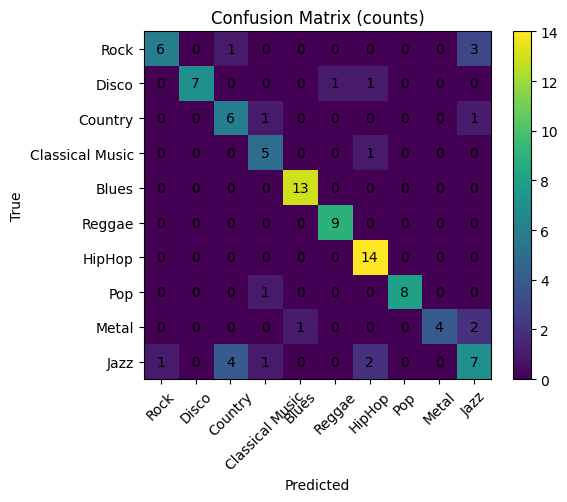

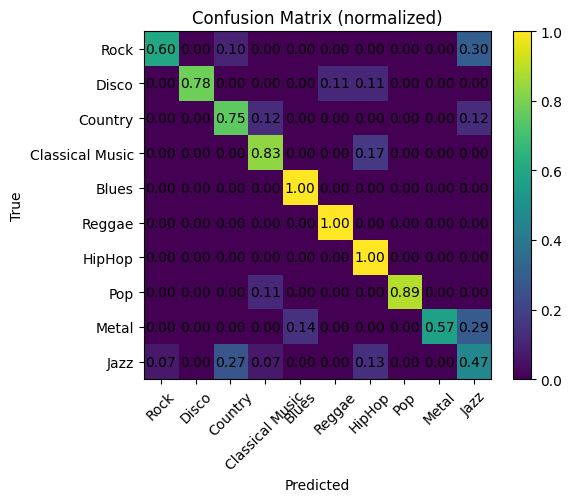

In [ ]:
from datasets import load_dataset, Audio
from transformers import AutoFeatureExtractor, AutoModelForAudioClassification, DataCollatorWithPadding
import torch
from torch.utils.data import DataLoader
from sklearn.metrics import confusion_matrix, classification_report
import os
os.environ["OPENBLAS_NUM_THREADS"] = "1"
import numpy as np
import matplotlib.pyplot as plt


gtzan = load_dataset("marsyas/gtzan")["train"]
gtzan = gtzan.cast_column("audio", Audio(sampling_rate=16_000))
split = gtzan.train_test_split(test_size=0.1, seed=42)
test_ds = split["test"]


model_path = "/content/drive/MyDrive/ml_project/fine_tuning1/checkpoint-500"
feature_extractor = AutoFeatureExtractor.from_pretrained(model_path)
model = AutoModelForAudioClassification.from_pretrained(model_path).to("cuda")
model.eval()


def preprocess(batch):
    proc = feature_extractor(
        batch["audio"]["array"],
        sampling_rate=16_000,
        padding=False,
        return_attention_mask=True
    )
    return {
        "input_values": proc["input_values"][0],
        "attention_mask": proc["attention_mask"][0],
        "labels": batch["genre"]
    }

test_proc = test_ds.map(preprocess, batched=False, remove_columns=test_ds.column_names)

# DataLoader
data_collator = DataCollatorWithPadding(feature_extractor, padding=True, return_tensors="pt")
test_loader = DataLoader(test_proc, batch_size=16, collate_fn=data_collator)

# Inferenza
all_preds, all_labels = [], []
with torch.no_grad():
    for batch in test_loader:
        iv = batch["input_values"].to("cuda")
        am = batch["attention_mask"].to("cuda")
        lbls = batch["labels"].to("cuda")
        out = model(iv, attention_mask=am)
        preds = torch.argmax(out.logits, dim=-1)
        all_preds.extend(preds.cpu().numpy())
        all_labels.extend(lbls.cpu().numpy())

#genre_labels = ["rock", "pop", "jazz", "classical", "hip-hop", "blues", "country", "electronic", "reggae", "metal"]
genre_labels = ["Rock", "Disco", "Country", "Classical Music", "Blues", "Reggae", "HipHop", "Pop", "Metal", "Jazz"]

# calcolo
cm = confusion_matrix(all_labels, all_preds)
cm_norm = cm.astype(float) / cm.sum(axis=1)[:,None]   #normalizzazione

# plot
def plot_cm(matrix, title, labels):
    plt.figure(figsize=(6,5))
    im = plt.imshow(matrix, interpolation="nearest", vmin=matrix.min(), vmax=matrix.max())
    plt.title(title)
    plt.colorbar(im)
    ticks = np.arange(len(labels))
    plt.xticks(ticks, labels, rotation=45)
    plt.yticks(ticks, labels)
    plt.xlabel("Predicted")
    plt.ylabel("True")
    for i in range(matrix.shape[0]):
        for j in range(matrix.shape[1]):
            val = matrix[i,j]
            text = f"{val:.2f}" if matrix.dtype==float else f"{int(val)}"
            plt.text(j, i, text, ha="center", va="center")
    plt.tight_layout()
    plt.show()


plot_cm(cm,      "Confusion Matrix (counts)",    genre_labels)
plot_cm(cm_norm, "Confusion Matrix (normalized)", genre_labels)

Worst confusion

In [ ]:
#  focus sulle misclassifications
cm_no_diag = cm.copy()
np.fill_diagonal(cm_no_diag, 0)

# confusione massima
true_idx, pred_idx = np.unravel_index(cm_no_diag.argmax(), cm_no_diag.shape)
print(f"› Most confused: true '{genre_labels[true_idx]}' → predicted '{genre_labels[pred_idx]}'"
      f" ({cm_no_diag.max()} instances)")


› Most confused: true 'Jazz' → predicted 'Country' (4 instances)


Per-class error rate

In [ ]:
from sklearn.metrics import recall_score

# recall for ciascuna classe
recalls = recall_score(all_labels, all_preds, average=None)
error_rates = 1 - recalls

plt.figure(figsize=(6,4))
plt.bar(genre_labels, error_rates)
plt.ylabel("Error rate (1 − recall)")
plt.title("Per‑Genre Error Rates")
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


CAMPIONI MISCLASSIFICATI

In [ ]:
# indici dei campioni misclassificati
mis_idx = [i for i, (t,p) in enumerate(zip(all_labels, all_preds)) if t != p]

# mostriamo i primi 10
for i in mis_idx[:10]:
    sample = test_ds[i]
    print(f"File: {sample['file']}\n"
          f"  True genre:      {genre_labels[sample['genre']]}\n"
          f"  Predicted genre: {genre_labels[all_preds[i]]}\n")

File: /root/.cache/huggingface/datasets/downloads/extracted/5022b0984afa7334ff9a3c60566280b08b5179d4ac96a628052bada7d8940244/genres/rock/rock.00078.wav
  True genre:      Jazz
  Predicted genre: Country

File: /root/.cache/huggingface/datasets/downloads/extracted/5022b0984afa7334ff9a3c60566280b08b5179d4ac96a628052bada7d8940244/genres/rock/rock.00034.wav
  True genre:      Jazz
  Predicted genre: HipHop

File: /root/.cache/huggingface/datasets/downloads/extracted/5022b0984afa7334ff9a3c60566280b08b5179d4ac96a628052bada7d8940244/genres/reggae/reggae.00011.wav
  True genre:      Metal
  Predicted genre: Blues

File: /root/.cache/huggingface/datasets/downloads/extracted/5022b0984afa7334ff9a3c60566280b08b5179d4ac96a628052bada7d8940244/genres/rock/rock.00094.wav
  True genre:      Jazz
  Predicted genre: HipHop

File: /root/.cache/huggingface/datasets/downloads/extracted/5022b0984afa7334ff9a3c60566280b08b5179d4ac96a628052bada7d8940244/genres/blues/blues.00061.wav
  True genre:      Rock
  Pre

File: /root/.cache/huggingface/datasets/downloads/extracted/5022b0984afa7334ff9a3c60566280b08b5179d4ac96a628052bada7d8940244/genres/classical/classical.00035.wav
True Genre:      classical
Predicted Genre: jazz


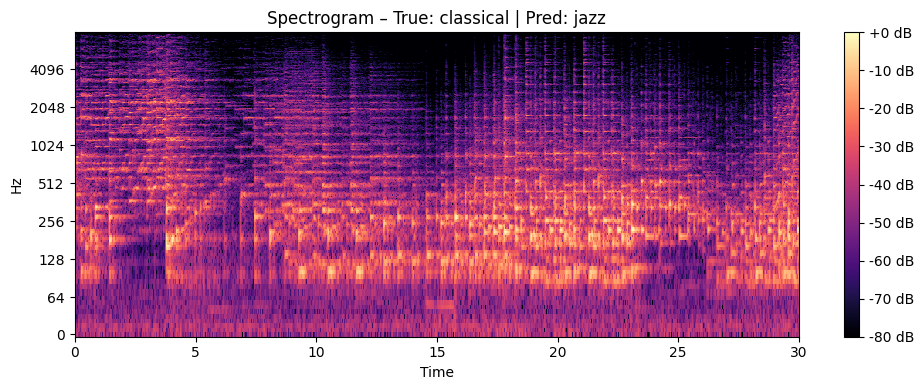

File: /root/.cache/huggingface/datasets/downloads/extracted/5022b0984afa7334ff9a3c60566280b08b5179d4ac96a628052bada7d8940244/genres/rock/rock.00094.wav
True Genre:      rock
Predicted Genre: metal


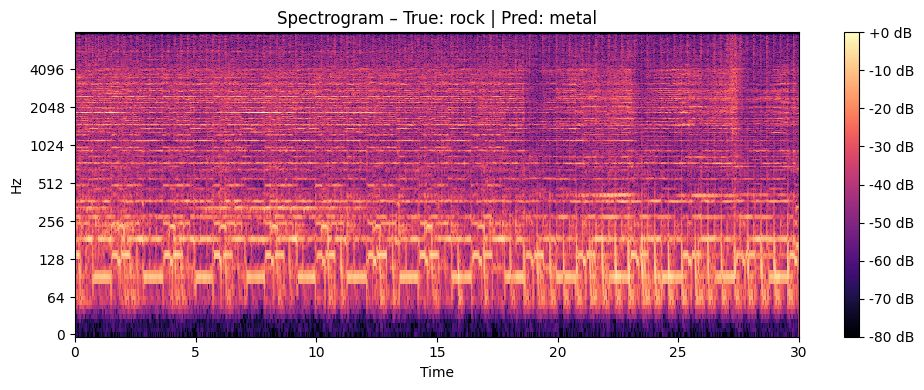

File: /root/.cache/huggingface/datasets/downloads/extracted/5022b0984afa7334ff9a3c60566280b08b5179d4ac96a628052bada7d8940244/genres/rock/rock.00078.wav
True Genre:      rock
Predicted Genre: country


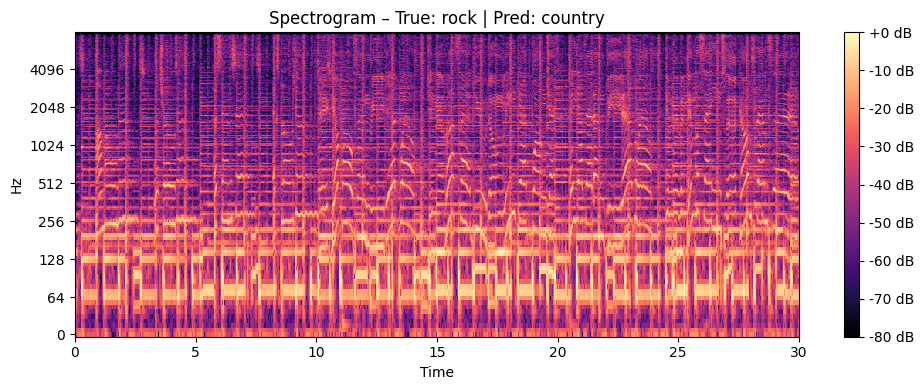

File: /root/.cache/huggingface/datasets/downloads/extracted/5022b0984afa7334ff9a3c60566280b08b5179d4ac96a628052bada7d8940244/genres/rock/rock.00004.wav
True Genre:      rock
Predicted Genre: country


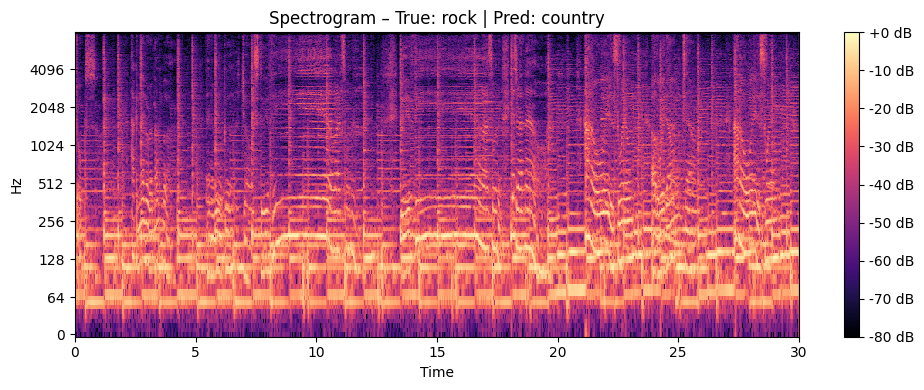

File: /root/.cache/huggingface/datasets/downloads/extracted/5022b0984afa7334ff9a3c60566280b08b5179d4ac96a628052bada7d8940244/genres/blues/blues.00007.wav
True Genre:      blues
Predicted Genre: country


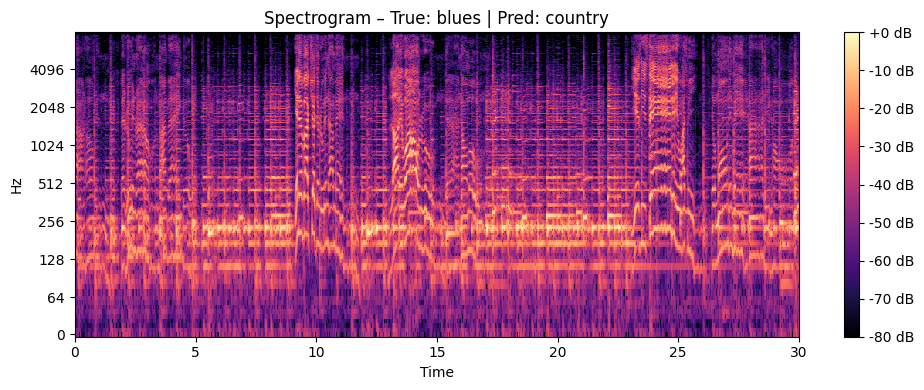

In [ ]:
import random
import librosa.display
import IPython.display as ipd
import numpy as np
import matplotlib.pyplot as plt


genre_labels = test_ds.features["genre"].names
#['blues', 'classical', 'country', 'disco', 'hiphop', 'jazz', 'metal', 'pop', 'reggae', 'rock']

random.seed(42)

# consideriamo gli indici di alcuni sample misclassificati
sampled_mis_idx = random.sample(mis_idx, 5)

for i in sampled_mis_idx:
    # prendiamo le etichette reali e quelle predette
    true_idx = all_labels[i]
    pred_idx = all_preds[i]
    true_label = genre_labels[true_idx]
    pred_label = genre_labels[pred_idx]

    # Consideriamo gli array audio e i rispettivi sampling rate
    sample = test_ds[i]
    audio_array = sample["audio"]["array"]
    sr = sample["audio"]["sampling_rate"]

    print(f"File: {sample['file']}")
    print(f"True Genre:      {true_label}")
    print(f"Predicted Genre: {pred_label}")

    # Plot spectrogram
    plt.figure(figsize=(10, 4))
    D = librosa.amplitude_to_db(np.abs(librosa.stft(audio_array)), ref=np.max)
    librosa.display.specshow(D, sr=sr, x_axis='time', y_axis='log')
    plt.colorbar(format='%+2.0f dB')
    plt.title(f"Spectrogram – True: {true_label} | Pred: {pred_label}")
    plt.tight_layout()
    plt.show()

    # Riproduzione dell'audio
    display(ipd.Audio(audio_array, rate=sr))


# Multilabel classification

In [ ]:
import numpy as np

genre_labels = ["rock", "pop", "jazz", "classical", "hip-hop", "blues", "country", "electronic", "reggae", "metal"]

def generate_probabilities_balanced(example):
    num_labels = len(genre_labels)
    main_label_range = (0.6, 0.9)  # Range per le etichette presenti
    non_present_range = (0.05, 0.3)  # Range per le etichette non presenti

    probabilities = np.zeros(num_labels)  # Inizializzazione delle probabilità

    # Identificazioni delle etichette presenti
    present_labels = example["genre"] if isinstance(example["genre"], list) else [example["genre"]]
    for label in present_labels:
        probabilities[label] = np.random.uniform(*main_label_range)  # Assegnamento di un valore casuale nell'intervallo dell'etichetta principale

    # Assegnamento valori casuali moderatamente alti alle etichette non presenti
    for label in range(num_labels):
        if label not in present_labels:
            probabilities[label] = np.random.uniform(*non_present_range)

    return {"genre_probabilities": probabilities.tolist()}
dataset = dataset.map(generate_probabilities_balanced)


Map:   0%|          | 0/799 [00:00<?, ? examples/s]

Map:   0%|          | 0/200 [00:00<?, ? examples/s]

In [ ]:
dataset

DatasetDict({
    train: Dataset({
        features: ['file', 'audio', 'genre', 'genre_probabilities'],
        num_rows: 799
    })
    test: Dataset({
        features: ['file', 'audio', 'genre', 'genre_probabilities'],
        num_rows: 200
    })
})

In [ ]:
df_multilabel = dataset.cast_column("audio", Audio(sampling_rate = 16000))

In [ ]:
import torch

max_duration = 30.0 # 30 secondi

def preprocess_function(examples):
    # estrazione degli array audio grezzi
    audio_arrays = [x['array'] for x in examples['audio']]
    # Preprocessing dell'audio con il feature_extractor
    inputs = feature_extractor(
        audio_arrays,
        sampling_rate=feature_extractor.sampling_rate,
        max_length=int(feature_extractor.sampling_rate * max_duration),
        padding=True,
        truncation=True,
        return_attention_mask=True
    )
    # Conversinene delle liste di liste in un array NumPy, quindi in un tensore.
    labels_np = np.array(examples["genre_probabilities"])
    # Controlliamo che il tensone abbia forma (batch_size, num_labels)
    inputs["labels"] = torch.tensor(labels_np, dtype=torch.float32)
    return inputs

#Precocessing del dataset con la funzione di pre-elaborazione appena definita
df_multilabel = df_multilabel.map(
    preprocess_function,
    remove_columns=['audio', 'file', "genre"],
    batched=True,
    batch_size=100,
    num_proc=1
)


Map:   0%|          | 0/799 [00:00<?, ? examples/s]

Map:   0%|          | 0/200 [00:00<?, ? examples/s]

In [ ]:
import torch
from transformers import AutoModelForAudioClassification

from transformers import AutoModelForAudioClassification
import torch
import torch.nn as nn

# caricamento del modello risultate del primo fine tuning
hubert_model = AutoModelForAudioClassification.from_pretrained(
    "/content/drive/MyDrive/ml_project/fine_tuning1/checkpoint-500"
)

# Modifica della testa di classificazione
num_labels = 10  # numeri di generi
hidden_size = hubert_model.classifier.in_features  # dimensione della testa originale

class MultilabelClassificationHead(nn.Module):
    def __init__(self, hidden_size, num_labels):
        super().__init__()
        self.fc = nn.Linear(hidden_size, num_labels)  # Layer lineare per i logits

    def forward(self, x):
        return self.fc(x)

# sostituzione della testa di classificazione con quella custom
hubert_model.classifier = MultilabelClassificationHead(hidden_size, num_labels)

# definizione del forward pass per includere la loss
class CustomHubertForMultilabelClassification(nn.Module):
    def __init__(self, base_model, num_labels):
        super().__init__()
        self.base_model = base_model
        self.num_labels = num_labels

    def forward(self, input_values, attention_mask=None, labels=None):
        # Forward pass al modello base
        outputs = self.base_model(input_values, attention_mask=attention_mask)
        logits = outputs.logits  # Raw logits from the new classification head

        loss = None
        if labels is not None:
            # Binary cross-entropy loss per multilabel classification
            loss_fn = nn.BCEWithLogitsLoss()
            loss = loss_fn(logits, labels)

        return {"loss": loss, "logits": logits}

# Wrap del modello con la classe custom
hubert_model = CustomHubertForMultilabelClassification(hubert_model, num_labels)


device = "cuda" if torch.cuda.is_available() else "cpu"
hubert_model.to(device)

CustomHubertForMultilabelClassification(
  (base_model): HubertForSequenceClassification(
    (hubert): HubertModel(
      (feature_extractor): HubertFeatureEncoder(
        (conv_layers): ModuleList(
          (0): HubertGroupNormConvLayer(
            (conv): Conv1d(1, 512, kernel_size=(10,), stride=(5,), bias=False)
            (activation): GELUActivation()
            (layer_norm): GroupNorm(512, 512, eps=1e-05, affine=True)
          )
          (1-4): 4 x HubertNoLayerNormConvLayer(
            (conv): Conv1d(512, 512, kernel_size=(3,), stride=(2,), bias=False)
            (activation): GELUActivation()
          )
          (5-6): 2 x HubertNoLayerNormConvLayer(
            (conv): Conv1d(512, 512, kernel_size=(2,), stride=(2,), bias=False)
            (activation): GELUActivation()
          )
        )
      )
      (feature_projection): HubertFeatureProjection(
        (projection): Linear(in_features=512, out_features=768, bias=True)
        (dropout): Dropout(p=0.0, inplac

In [ ]:
print(df_multilabel["train"][3]["labels"])

[0.092631034553051, 0.06626290082931519, 0.782263457775116, 0.28722137212753296, 0.2914080023765564, 0.25209933519363403, 0.12615343928337097, 0.07441803067922592, 0.22105824947357178, 0.16003812849521637]


In [ ]:
df_multilabel["train"] = df_multilabel["train"].remove_columns(["genre_probabilities"])
df_multilabel["test"] = df_multilabel["test"].remove_columns(["genre_probabilities"])

In [ ]:
from sklearn.metrics import precision_score, recall_score, hamming_loss, roc_auc_score, f1_score

def compute_metrics(eval_pred):
    logits, labels = eval_pred

    print(f"Logits range: {logits.min()} - {logits.max()} | Labels range: {labels.min()} - {labels.max()}")

    # Conversione dei logits in probabilità
    probabilities = torch.sigmoid(torch.tensor(logits)).numpy()

    # Initializzazione delle metriche
    roc_auc_list = []
    precision_list = []
    recall_list = []

    # Calcolo della ROC-AUC per ciascuna etichetta
    for i in range(labels.shape[1]):
        try:
            roc_auc = roc_auc_score(labels[:, i], probabilities[:, i])
            roc_auc_list.append(roc_auc)
        except ValueError:
            roc_auc_list.append(float('nan'))

    # media ROC-AUC
    roc_auc_mean = np.nanmean(roc_auc_list)

    # Rendiamo binarie predizioni ed etichette per il calcolo delle metriche
    threshold = 0.5
    predictions = (probabilities >= threshold).astype(int)
    labels_binary = (labels >= threshold).astype(int)

    # Calcolo delle macro-averaged Precision and Recall
    precision = precision_score(labels_binary, predictions, average="macro")
    recall = recall_score(labels_binary, predictions, average="macro")

    # Calcolo F1 score
    f1 = f1_score(labels_binary, predictions, average="macro")

    # Calcolo Hamming Loss
    hamming = hamming_loss(labels_binary, predictions)

    return {
        "roc_auc": roc_auc_mean,
        "f1": f1,
        "precision": precision,
        "recall": recall,
        "hamming_loss": hamming,
    }

In [ ]:
dummy_logits = np.random.rand(10, 10)  # logits (simulati)
dummy_labels = np.random.rand(10, 10)  # etichette con probabilità (simulate)
metrics = compute_metrics((dummy_logits, dummy_labels))
print(metrics)

Logits range: 0.0009430425274903342 - 0.9852073259110937 | Labels range: 0.014470641502865034 - 0.9935015603957081
{'roc_auc': np.float64(nan), 'f1': 0.5978291316526612, 'precision': 0.45, 'recall': 1.0, 'hamming_loss': 0.55}


<ipython-input-96-1399739590>:25: RuntimeWarning: Mean of empty slice
  roc_auc_mean = np.nanmean(roc_auc_list)


In [ ]:
#import os
#os.environ["WANDB_DISABLED"] = "true"

In [ ]:
from transformers import TrainingArguments, Trainer
from transformers import AutoModel

training_args = TrainingArguments(
    output_dir='/content/drive/MyDrive/ml_project/multilabel_model_test',
    eval_strategy='epoch',
    save_strategy='epoch',
    load_best_model_at_end=True,
    metric_for_best_model='f1',
    learning_rate=3e-5,
    seed=seed,
    per_device_train_batch_size=4,
    per_device_eval_batch_size=4,
    gradient_accumulation_steps=4,
    num_train_epochs=20,
    warmup_ratio=0.1,
    fp16=True,
    save_total_limit=2,
    logging_strategy="epoch",
    logging_steps=100,  # Log training loss ogni 10 steps
    report_to="none",  # disabilitiamo Wandb
)

#checkpoint_path = "/content/drive/MyDrive/ml_project/multilabel_model/checkpoint-500".
#hubert_model = AutoModel.from_pretrained(checkpoint_path)  # Load the model from the checkpoint


In [ ]:
trainer = Trainer(
    model=hubert_model,
    args=training_args,
    train_dataset=df_multilabel["train"],
    eval_dataset=df_multilabel["test"],
    tokenizer=feature_extractor,
    compute_metrics=compute_metrics,
)

#trainer.train()

<ipython-input-100-4257129964>:1: FutureWarning: `tokenizer` is deprecated and will be removed in version 5.0.0 for `Trainer.__init__`. Use `processing_class` instead.
  trainer = Trainer(


# Multilabel Classification test

In [ ]:
# Evaluate del modello sul test set
predictions = trainer.predict(test_datasetc=df_multilabel["test"])

# Estrazione logits
logits = predictions.predictions

# Applichiamo la sigmoide per ottenere le probabilità
probabilities = torch.sigmoid(torch.tensor(logits)).numpy()

# Stampiamo le probabilità per qualche sample
print("Probabilities for each genre (first 5 samples):")
print(probabilities[:5])


Logits range: -1.4208984375 - 1.7431640625 | Labels range: 0.05001320689916611 - 0.8988038301467896


<ipython-input-96-1399739590>:25: RuntimeWarning: Mean of empty slice
  roc_auc_mean = np.nanmean(roc_auc_list)


Probabilities for each genre (first 5 samples):
[[0.33906123 0.7111301  0.59089726 0.49551785 0.55441016 0.4248295
  0.47782826 0.452415   0.53543246 0.26855758]
 [0.49830917 0.37966582 0.5669778  0.45783356 0.50006706 0.5327594
  0.3860688  0.40969306 0.4282334  0.3333947 ]
 [0.44513753 0.6727618  0.46171448 0.467818   0.532182   0.5927255
  0.6302299  0.39501747 0.552932   0.5435902 ]
 [0.43392146 0.5645187  0.6007155  0.47418985 0.5649387  0.55661047
  0.38271806 0.46842587 0.4009839  0.34676248]
 [0.6657367  0.32402146 0.50625575 0.41483957 0.43554133 0.40080798
  0.23810701 0.4531106  0.7079098  0.39111522]]


In [ ]:
genre_labels = ["rock", "pop", "jazz", "classical", "hip-hop", "blues", "country", "electronic", "reggae", "metal"]

for i, probs in enumerate(probabilities[:5]):  # stampa per i primi 5 campioni
    print(f"Sample {i+1}:")
    for genre, prob in zip(genre_labels, probs):
        print(f"  {genre}: {prob:.2f}")

Sample 1:
  rock: 0.34
  pop: 0.71
  jazz: 0.59
  classical: 0.50
  hip-hop: 0.55
  blues: 0.42
  country: 0.48
  electronic: 0.45
  reggae: 0.54
  metal: 0.27
Sample 2:
  rock: 0.50
  pop: 0.38
  jazz: 0.57
  classical: 0.46
  hip-hop: 0.50
  blues: 0.53
  country: 0.39
  electronic: 0.41
  reggae: 0.43
  metal: 0.33
Sample 3:
  rock: 0.45
  pop: 0.67
  jazz: 0.46
  classical: 0.47
  hip-hop: 0.53
  blues: 0.59
  country: 0.63
  electronic: 0.40
  reggae: 0.55
  metal: 0.54
Sample 4:
  rock: 0.43
  pop: 0.56
  jazz: 0.60
  classical: 0.47
  hip-hop: 0.56
  blues: 0.56
  country: 0.38
  electronic: 0.47
  reggae: 0.40
  metal: 0.35
Sample 5:
  rock: 0.67
  pop: 0.32
  jazz: 0.51
  classical: 0.41
  hip-hop: 0.44
  blues: 0.40
  country: 0.24
  electronic: 0.45
  reggae: 0.71
  metal: 0.39
